# Case Study: Clustering 

In [20]:
using DataFrames
using CSV

In [21]:
houses = CSV.File("data/newhouses.csv") |> DataFrame

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population
,Float64,Float64,Float64,Float64,Float64?,Float64
1,-122.23,37.88,41.0,880.0,129.0,322.0
2,-122.22,37.86,21.0,7099.0,1106.0,2401.0
3,-122.24,37.85,52.0,1467.0,190.0,496.0
4,-122.25,37.85,52.0,1274.0,235.0,558.0
5,-122.25,37.85,52.0,1627.0,280.0,565.0
6,-122.25,37.85,52.0,919.0,213.0,413.0
7,-122.25,37.84,52.0,2535.0,489.0,1094.0
8,-122.25,37.84,52.0,3104.0,687.0,1157.0
9,-122.26,37.84,42.0,2555.0,665.0,1206.0


In [22]:
names(houses)

10-element Array{String,1}:
 "longitude"
 "latitude"
 "housing_median_age"
 "total_rooms"
 "total_bedrooms"
 "population"
 "households"
 "median_income"
 "median_house_value"
 "ocean_proximity"

## Visually Representing Map Data

We will use Vega-Lite to visually represent the housing data on a map of california. Required packages will all be made available using the following code. Files are included in the `data` folder. 

In [ ]:
] add JSON

In [ ]:
] add VegaLite

In [ ]:
] add VegaDatasets

In [23]:
using JSON
using VegaLite
using VegaDatasets

In [24]:
cali_shape = JSON.parsefile("data/california-counties.json")
VV = VegaDatasets.VegaJSONDataset(cali_shape, "data/california-counties.json")

Vega JSON Dataset

2021-03-17 22:02:09.705 node[70134:2481256] XType: failed to connect - Error Domain=NSCocoaErrorDomain Code=4099 "The connection to service on pid 0 named com.apple.fonts was invalidated." UserInfo={NSDebugDescription=The connection to service on pid 0 named com.apple.fonts was invalidated.}
2021-03-17 22:02:09.705 node[70134:2481256] Font server protocol version mismatch (expected:5 got:0), falling back to local fonts
2021-03-17 22:02:09.705 node[70134:2481256] XType: unable to make a connection to the font daemon!
2021-03-17 22:02:09.705 node[70134:2481256] registering /System/Library/Fonts/*, /System/Library/Fonts/Base/*, and /System/Library/Fonts/Supplemental/* locally
2021-03-17 22:02:14.335 node[70136:2481337] XType: failed to connect - Error Domain=NSCocoaErrorDomain Code=4099 "The connection to service on pid 0 named com.apple.fonts was invalidated." UserInfo={NSDebugDescription=The connection to service on pid 0 named com.apple.fonts was invalidated.}
2021-03-17 22:02:14.335 n

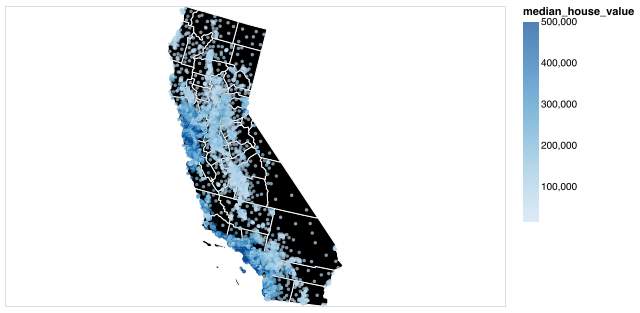

In [25]:
@vlplot(width=500, height=300) +
@vlplot(
    mark={
        :geoshape,
        fill=:black,
        stroke=:white
    },
    data={
        values=VV,
        format={
            type=:topojson,
            feature=:cb_2015_california_county_20m
        }
    },
    projection={
        type=:albersUsa
    },
)+
@vlplot(
    :circle,
    data=houses,
    projection={
        type=:albersUsa
    },
    longitude="longitude:q",
    latitude="latitude:q",
    size={
        value=12
    },
    color="median_house_value:q"
                    
)

## Division based on Price

Let's split the dataset into groups. Each group will be a multiple of 100k (according to price). 

In [26]:
bucketprice = Int.(div.(houses[!, :median_house_value], 100000))

20640-element Array{Int64,1}:
 4
 3
 3
 3
 3
 2
 2
 2
 2
 2
 2
 2
 2
 ⋮
 0
 1
 1
 1
 1
 0
 1
 0
 0
 0
 0
 0

In [27]:
extrema(bucketprice)

(0, 5)

In [28]:
insertcols!(houses, 3, :cprice => bucketprice)

,longitude,latitude,cprice,housing_median_age,total_rooms,total_bedrooms,population
,Float64,Float64,Int64,Float64,Float64,Float64?,Float64
1,-122.23,37.88,4,41.0,880.0,129.0,322.0
2,-122.22,37.86,3,21.0,7099.0,1106.0,2401.0
3,-122.24,37.85,3,52.0,1467.0,190.0,496.0
4,-122.25,37.85,3,52.0,1274.0,235.0,558.0
5,-122.25,37.85,3,52.0,1627.0,280.0,565.0
6,-122.25,37.85,2,52.0,919.0,213.0,413.0
7,-122.25,37.84,2,52.0,2535.0,489.0,1094.0
8,-122.25,37.84,2,52.0,3104.0,687.0,1157.0
9,-122.26,37.84,2,42.0,2555.0,665.0,1206.0


2021-03-17 22:06:07.094 node[70177:2482878] XType: failed to connect - Error Domain=NSCocoaErrorDomain Code=4099 "The connection to service on pid 0 named com.apple.fonts was invalidated." UserInfo={NSDebugDescription=The connection to service on pid 0 named com.apple.fonts was invalidated.}
2021-03-17 22:06:07.094 node[70177:2482878] Font server protocol version mismatch (expected:5 got:0), falling back to local fonts
2021-03-17 22:06:07.094 node[70177:2482878] XType: unable to make a connection to the font daemon!
2021-03-17 22:06:07.094 node[70177:2482878] registering /System/Library/Fonts/*, /System/Library/Fonts/Base/*, and /System/Library/Fonts/Supplemental/* locally
2021-03-17 22:06:11.735 node[70180:2482959] XType: failed to connect - Error Domain=NSCocoaErrorDomain Code=4099 "The connection to service on pid 0 named com.apple.fonts was invalidated." UserInfo={NSDebugDescription=The connection to service on pid 0 named com.apple.fonts was invalidated.}
2021-03-17 22:06:11.735 n

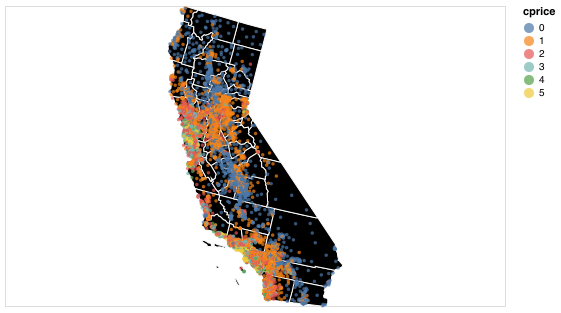

In [29]:
@vlplot(width=500, height=300) +
@vlplot(
    mark={
        :geoshape,
        fill=:black,
        stroke=:white
    },
    data={
        values=VV,
        format={
            type=:topojson,
            feature=:cb_2015_california_county_20m
        }
    },
    projection={
        type=:albersUsa
    },
)+
@vlplot(
    :circle,
    data=houses,
    projection={
        type=:albersUsa
    },
    longitude="longitude:q",
    latitude="latitude:q",
    size={
        value=12
    },
    color="cprice:n" # this is different 
) 

## K-means Clustering

In [ ]:
] add Clustering

In [30]:
using Clustering

In [31]:
houses = dropmissing(houses)

,longitude,latitude,cprice,housing_median_age,total_rooms,total_bedrooms,population
,Float64,Float64,Int64,Float64,Float64,Float64,Float64
1,-122.23,37.88,4,41.0,880.0,129.0,322.0
2,-122.22,37.86,3,21.0,7099.0,1106.0,2401.0
3,-122.24,37.85,3,52.0,1467.0,190.0,496.0
4,-122.25,37.85,3,52.0,1274.0,235.0,558.0
5,-122.25,37.85,3,52.0,1627.0,280.0,565.0
6,-122.25,37.85,2,52.0,919.0,213.0,413.0
7,-122.25,37.84,2,52.0,2535.0,489.0,1094.0
8,-122.25,37.84,2,52.0,3104.0,687.0,1157.0
9,-122.26,37.84,2,42.0,2555.0,665.0,1206.0


In [32]:
X = houses[!, [:median_house_value]] # Select in-place. Don't create a copy. 

In [33]:
size(X) # currently a column vector 

(20433, 1)

In [ ]:
C = kmeans(Matrix(X)', 5) # K-means needs a row vector 

In [ ]:
insertcols!(houses, 3, :cluster_k => C.assignments)

In [ ]:
@vlplot(width=500, height=300) +
@vlplot(
    mark={
        :geoshape,
        fill=:black,
        stroke=:white
    },
    data={
        values=VV,
        format={
            type=:topojson,
            feature=:cb_2015_california_county_20m
        }
    },
    projection={
        type=:albersUsa
    },
)+
@vlplot(
    :circle,
    data=houses,
    projection={
        type=:albersUsa
    },
    longitude="longitude:q",
    latitude="latitude:q",
    size={
        value=12
    },
    color="cluster_k:n"
                    
)